### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?

In [1]:
import pandas as pd

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


## NO LINEAL REGRESSION POLYNOMIAL

In [2]:
#importing libraries
# Import function to create training and test set splits
from sklearn.model_selection import train_test_split
# Import function to automatically create polynomial features! 
from sklearn.preprocessing import PolynomialFeatures
# Import Linear Regression
from sklearn.linear_model import LinearRegression
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.metrics import r2_score, mean_absolute_error

import numpy as np

## Data Wrangling

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
 6   Address                       5000 non-null   object 
dtypes: float64(6), object(1)
memory usage: 273.6+ KB


In [4]:
df = df.drop(["Address"], axis=1)  # removing "Address" column, type object

In [5]:
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05
...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06


## Initialize parameters X and y

## X= Avg. Area Income
## y = Price

In [6]:
X_income = np.array(df["Avg. Area Income"])
y = np.array(df["Price"]) #target

In [7]:
print("X_income:", X_income.shape)
print("y:",y.shape)

X_income: (5000,)
y: (5000,)


## Step-1  Test/train split  

In [8]:
X_train_income, X_test_income, y_train_income, y_test_income = train_test_split(X_income, y, test_size=0.2) #previus step

In [9]:
X_train_income

array([67160.85009496, 60798.20309974, 76547.95669777, ...,
       68785.20331161, 72252.60270676, 70185.7442822 ])

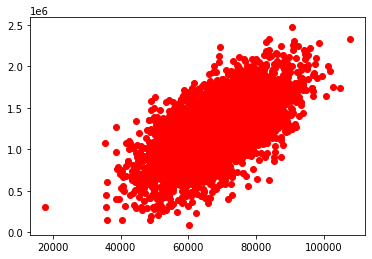

In [10]:
plt.scatter(X_train_income, y_train_income, color='red')


## Step -2 Polynomial Features(degree)

################
[[1.00000000e+00 6.71608501e+04 4.51057979e+09]
 [1.00000000e+00 6.07982031e+04 3.69642150e+09]
 [1.00000000e+00 7.65479567e+04 5.85958967e+09]
 ...
 [1.00000000e+00 6.87852033e+04 4.73140419e+09]
 [1.00000000e+00 7.22526027e+04 5.22043860e+09]
 [1.00000000e+00 7.01857443e+04 4.92603870e+09]]
(4000, 3)
y_pred_income (4000,)
Score: 0.4085630528990447
MAE: 218072.9299849791


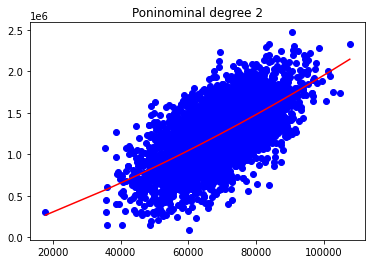

################
[[1.00000000e+00 6.71608501e+04 4.51057979e+09 3.02934373e+14]
 [1.00000000e+00 6.07982031e+04 3.69642150e+09 2.24735785e+14]
 [1.00000000e+00 7.65479567e+04 5.85958967e+09 4.48539617e+14]
 ...
 [1.00000000e+00 6.87852033e+04 4.73140419e+09 3.25450599e+14]
 [1.00000000e+00 7.22526027e+04 5.22043860e+09 3.77190276e+14]
 [1.00000000e+00 7.01857443e+04 4.92603870e+09 3.45737693e+14]]
(4000, 4)
y_pred_income (4000,)
Score: 0.4085849105619258
MAE: 218061.93902722548


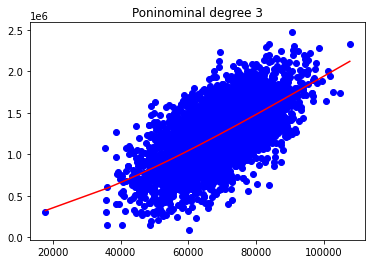

################
[[1.00000000e+00 6.71608501e+04 4.51057979e+09 3.02934373e+14
  2.03453300e+19]
 [1.00000000e+00 6.07982031e+04 3.69642150e+09 2.24735785e+14
  1.36635319e+19]
 [1.00000000e+00 7.65479567e+04 5.85958967e+09 4.48539617e+14
  3.43347912e+19]
 ...
 [1.00000000e+00 6.87852033e+04 4.73140419e+09 3.25450599e+14
  2.23861857e+19]
 [1.00000000e+00 7.22526027e+04 5.22043860e+09 3.77190276e+14
  2.72529792e+19]
 [1.00000000e+00 7.01857443e+04 4.92603870e+09 3.45737693e+14
  2.42658573e+19]]
(4000, 5)
y_pred_income (4000,)
Score: 0.40858466749521627
MAE: 218068.30655622532


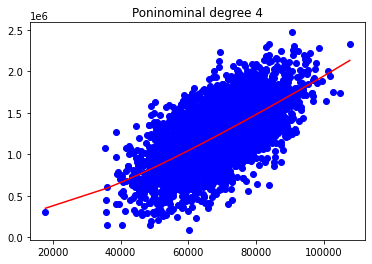

################
[[1.00000000e+00 6.71608501e+04 4.51057979e+09 3.02934373e+14
  2.03453300e+19 1.36640966e+24]
 [1.00000000e+00 6.07982031e+04 3.69642150e+09 2.24735785e+14
  1.36635319e+19 8.30718188e+23]
 [1.00000000e+00 7.65479567e+04 5.85958967e+09 4.48539617e+14
  3.43347912e+19 2.62825811e+24]
 ...
 [1.00000000e+00 6.87852033e+04 4.73140419e+09 3.25450599e+14
  2.23861857e+19 1.53983833e+24]
 [1.00000000e+00 7.22526027e+04 5.22043860e+09 3.77190276e+14
  2.72529792e+19 1.96909868e+24]
 [1.00000000e+00 7.01857443e+04 4.92603870e+09 3.45737693e+14
  2.42658573e+19 1.70311725e+24]]
(4000, 6)
y_pred_income (4000,)
Score: 0.40855442578656165
MAE: 218089.57339333356


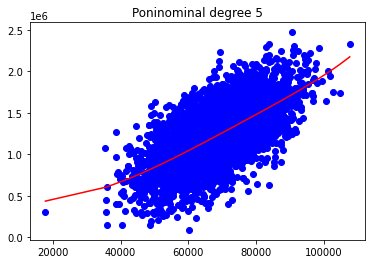

################
[[1.00000000e+00 6.71608501e+04 4.51057979e+09 ... 2.03453300e+19
  1.36640966e+24 9.17692342e+28]
 [1.00000000e+00 6.07982031e+04 3.69642150e+09 ... 1.36635319e+19
  8.30718188e+23 5.05061731e+28]
 [1.00000000e+00 7.65479567e+04 5.85958967e+09 ... 3.43347912e+19
  2.62825811e+24 2.01187788e+29]
 ...
 [1.00000000e+00 6.87852033e+04 4.73140419e+09 ... 2.23861857e+19
  1.53983833e+24 1.05918093e+29]
 [1.00000000e+00 7.22526027e+04 5.22043860e+09 ... 2.72529792e+19
  1.96909868e+24 1.42272504e+29]
 [1.00000000e+00 7.01857443e+04 4.92603870e+09 ... 2.42658573e+19
  1.70311725e+24 1.19534552e+29]]
(4000, 7)
y_pred_income (4000,)
Score: 0.4083537267239721
MAE: 218124.73956041635


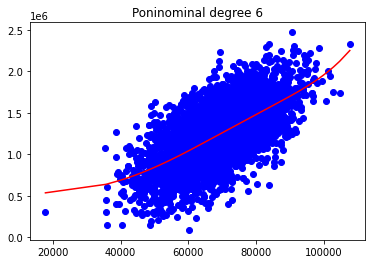

################
[[1.00000000e+00 6.71608501e+04 4.51057979e+09 ... 1.36640966e+24
  9.17692342e+28 6.16329978e+33]
 [1.00000000e+00 6.07982031e+04 3.69642150e+09 ... 8.30718188e+23
  5.05061731e+28 3.07068457e+33]
 [1.00000000e+00 7.65479567e+04 5.85958967e+09 ... 2.62825811e+24
  2.01187788e+29 1.54005141e+34]
 ...
 [1.00000000e+00 6.87852033e+04 4.73140419e+09 ... 1.53983833e+24
  1.05918093e+29 7.28559754e+33]
 [1.00000000e+00 7.22526027e+04 5.22043860e+09 ... 1.96909868e+24
  1.42272504e+29 1.02795587e+34]
 [1.00000000e+00 7.01857443e+04 4.92603870e+09 ... 1.70311725e+24
  1.19534552e+29 8.38962150e+33]]
(4000, 8)
y_pred_income (4000,)
Score: 0.40770422330546396
MAE: 218234.3281638519


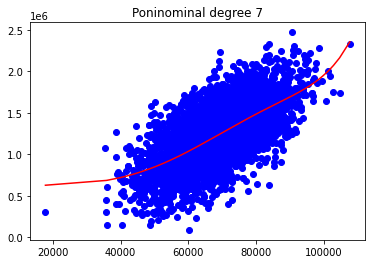

################
[[1.00000000e+00 6.71608501e+04 4.51057979e+09 ... 9.17692342e+28
  6.16329978e+33 4.13932453e+38]
 [1.00000000e+00 6.07982031e+04 3.69642150e+09 ... 5.05061731e+28
  3.07068457e+33 1.86692104e+38]
 [1.00000000e+00 7.65479567e+04 5.85958967e+09 ... 2.01187788e+29
  1.54005141e+34 1.17887788e+39]
 ...
 [1.00000000e+00 6.87852033e+04 4.73140419e+09 ... 1.05918093e+29
  7.28559754e+33 5.01141308e+38]
 [1.00000000e+00 7.22526027e+04 5.22043860e+09 ... 1.42272504e+29
  1.02795587e+34 7.42724873e+38]
 [1.00000000e+00 7.01857443e+04 4.92603870e+09 ... 1.19534552e+29
  8.38962150e+33 5.88831829e+38]]
(4000, 9)
y_pred_income (4000,)
Score: 0.40622429578277763
MAE: 218496.9746408942


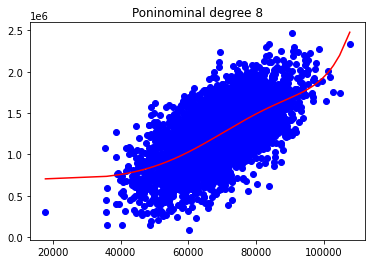

################
[[1.00000000e+00 6.71608501e+04 4.51057979e+09 ... 6.16329978e+33
  4.13932453e+38 2.78000554e+43]
 [1.00000000e+00 6.07982031e+04 3.69642150e+09 ... 3.07068457e+33
  1.86692104e+38 1.13505445e+43]
 [1.00000000e+00 7.65479567e+04 5.85958967e+09 ... 1.54005141e+34
  1.17887788e+39 9.02406932e+43]
 ...
 [1.00000000e+00 6.87852033e+04 4.73140419e+09 ... 7.28559754e+33
  5.01141308e+38 3.44711068e+43]
 [1.00000000e+00 7.22526027e+04 5.22043860e+09 ... 1.02795587e+34
  7.42724873e+38 5.36638052e+43]
 [1.00000000e+00 7.01857443e+04 4.92603870e+09 ... 8.38962150e+33
  5.88831829e+38 4.13276002e+43]]
(4000, 10)
y_pred_income (4000,)
Score: 0.40352328350196487
MAE: 218992.53401040536


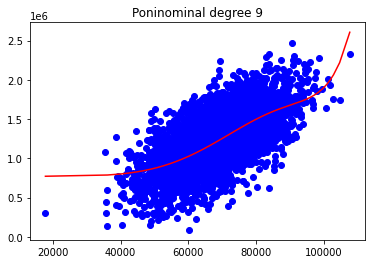

################
[[1.00000000e+00 6.71608501e+04 4.51057979e+09 ... 4.13932453e+38
  2.78000554e+43 1.86707535e+48]
 [1.00000000e+00 6.07982031e+04 3.69642150e+09 ... 1.86692104e+38
  1.13505445e+43 6.90092708e+47]
 [1.00000000e+00 7.65479567e+04 5.85958967e+09 ... 1.17887788e+39
  9.02406932e+43 6.90774067e+48]
 ...
 [1.00000000e+00 6.87852033e+04 4.73140419e+09 ... 5.01141308e+38
  3.44711068e+43 2.37110209e+48]
 [1.00000000e+00 7.22526027e+04 5.22043860e+09 ... 7.42724873e+38
  5.36638052e+43 3.87734959e+48]
 [1.00000000e+00 7.01857443e+04 4.92603870e+09 ... 5.88831829e+38
  4.13276002e+43 2.90060838e+48]]
(4000, 11)
y_pred_income (4000,)
Score: 0.39928608193846127
MAE: 219738.0308951358


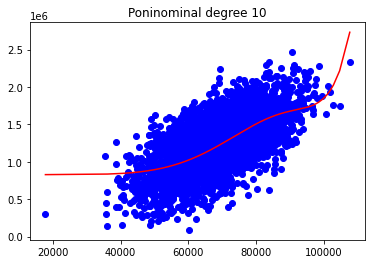

In [11]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores = []
for degree in range(degree_min,degree_max+1):
    
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train_income.reshape(-1, 1),y_train_income)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train_income)
    y_pred_income = lin_reg_model.predict(X_poly)
    print("y_pred_income", y_pred_income.shape)
    print("Score:", r2_score(y_train_income, y_pred_income))
    print("MAE:", mean_absolute_error(y_true=y_train_income, y_pred=y_pred_income))
    score = r2_score(y_train_income, y_pred_income)
    scores.append(score)
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train_income, y_train_income)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred_income = zip(*sorted(zip(X_train_income, y_pred_income)))
    plt.plot(X_train_to_show, y_pred_income, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()

    input("Enter to next grade")


In [12]:
print("SCORES DEGREE FROM 2 TO 10:", scores)    

SCORES DEGREE FROM 2 TO 10: [0.4085630528990447, 0.4085849105619258, 0.40858466749521627, 0.40855442578656165, 0.4083537267239721, 0.40770422330546396, 0.40622429578277763, 0.40352328350196487, 0.39928608193846127]


### We can observ that after the third degree our score no longer shows significant improvement and therefore it's not usefull to continue forcing it .

## X= Avg. Area House Age
## y = Price

In [13]:
X_age = np.array(df["Avg. Area House Age"])
y = np.array(df["Price"]) #target

print("X_age:", X_age.shape)
print("y:",y.shape)

X_age: (5000,)
y: (5000,)


In [14]:
X_train_age, X_test_age, y_train_age, y_test_age = train_test_split(X_age, y, test_size=0.2) #previus step

################
[[ 1.          7.00615575 49.08621833]
 [ 1.          6.41122178 41.10376473]
 [ 1.          4.61591791 21.30669816]
 ...
 [ 1.          6.37806605 40.67972654]
 [ 1.          7.29753282 53.25398531]
 [ 1.          6.02250924 36.27061758]]
(4000, 3)
y_pred_age (4000,)
Score: 0.2086351233146697
MAE: 249693.7363921111


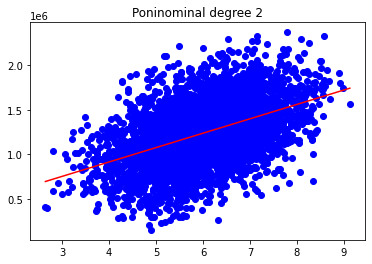

################
[[  1.           7.00615575  49.08621833 343.90569061]
 [  1.           6.41122178  41.10376473 263.52535169]
 [  1.           4.61591791  21.30669816  98.34996967]
 ...
 [  1.           6.37806605  40.67972654 259.45798274]
 [  1.           7.29753282  53.25398531 388.62270575]
 [  1.           6.02250924  36.27061758 218.44012959]]
(4000, 4)
y_pred_age (4000,)
Score: 0.2088123561095956
MAE: 249691.10260826474


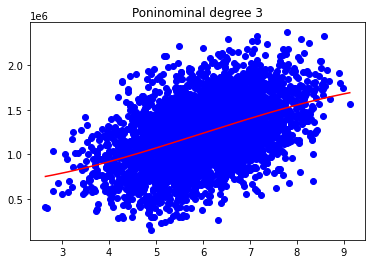

################
[[1.00000000e+00 7.00615575e+00 4.90862183e+01 3.43905691e+02
  2.40945683e+03]
 [1.00000000e+00 6.41122178e+00 4.11037647e+01 2.63525352e+02
  1.68951947e+03]
 [1.00000000e+00 4.61591791e+00 2.13066982e+01 9.83499697e+01
  4.53975387e+02]
 ...
 [1.00000000e+00 6.37806605e+00 4.06797265e+01 2.59457983e+02
  1.65484015e+03]
 [1.00000000e+00 7.29753282e+00 5.32539853e+01 3.88622706e+02
  2.83598695e+03]
 [1.00000000e+00 6.02250924e+00 3.62706176e+01 2.18440130e+02
  1.31555770e+03]]
(4000, 5)
y_pred_age (4000,)
Score: 0.20892305759582763
MAE: 249654.13484287652


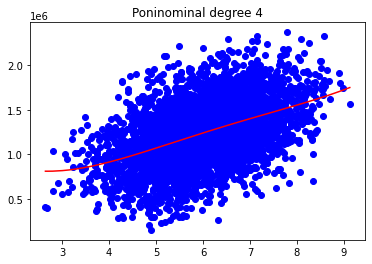

################
[[1.00000000e+00 7.00615575e+00 4.90862183e+01 3.43905691e+02
  2.40945683e+03 1.68810298e+04]
 [1.00000000e+00 6.41122178e+00 4.11037647e+01 2.63525352e+02
  1.68951947e+03 1.08318841e+04]
 [1.00000000e+00 4.61591791e+00 2.13066982e+01 9.83499697e+01
  4.53975387e+02 2.09551312e+03]
 ...
 [1.00000000e+00 6.37806605e+00 4.06797265e+01 2.59457983e+02
  1.65484015e+03 1.05546798e+04]
 [1.00000000e+00 7.29753282e+00 5.32539853e+01 3.88622706e+02
  2.83598695e+03 2.06957079e+04]
 [1.00000000e+00 6.02250924e+00 3.62706176e+01 2.18440130e+02
  1.31555770e+03 7.92295840e+03]]
(4000, 6)
y_pred_age (4000,)
Score: 0.21036231674888362
MAE: 249275.88259097695


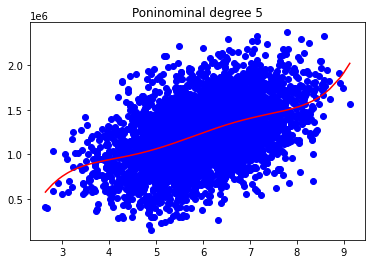

################
[[1.00000000e+00 7.00615575e+00 4.90862183e+01 ... 2.40945683e+03
  1.68810298e+04 1.18271124e+05]
 [1.00000000e+00 6.41122178e+00 4.11037647e+01 ... 1.68951947e+03
  1.08318841e+04 6.94456110e+04]
 [1.00000000e+00 4.61591791e+00 2.13066982e+01 ... 4.53975387e+02
  2.09551312e+03 9.67271653e+03]
 ...
 [1.00000000e+00 6.37806605e+00 4.06797265e+01 ... 1.65484015e+03
  1.05546798e+04 6.73184448e+04]
 [1.00000000e+00 7.29753282e+00 5.32539853e+01 ... 2.83598695e+03
  2.06957079e+04 1.51027607e+05]
 [1.00000000e+00 6.02250924e+00 3.62706176e+01 ... 1.31555770e+03
  7.92295840e+03 4.77160902e+04]]
(4000, 7)
y_pred_age (4000,)
Score: 0.2104995097864074
MAE: 249216.67162401992


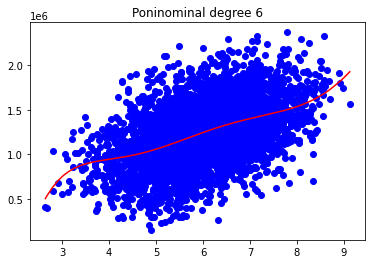

################
[[1.00000000e+00 7.00615575e+00 4.90862183e+01 ... 1.68810298e+04
  1.18271124e+05 8.28625915e+05]
 [1.00000000e+00 6.41122178e+00 4.11037647e+01 ... 1.08318841e+04
  6.94456110e+04 4.45231214e+05]
 [1.00000000e+00 4.61591791e+00 2.13066982e+01 ... 2.09551312e+03
  9.67271653e+03 4.46484655e+04]
 ...
 [1.00000000e+00 6.37806605e+00 4.06797265e+01 ... 1.05546798e+04
  6.73184448e+04 4.29361487e+05]
 [1.00000000e+00 7.29753282e+00 5.32539853e+01 ... 2.06957079e+04
  1.51027607e+05 1.10212892e+06]
 [1.00000000e+00 6.02250924e+00 3.62706176e+01 ... 7.92295840e+03
  4.77160902e+04 2.87370594e+05]]
(4000, 8)
y_pred_age (4000,)
Score: 0.21092859638527417
MAE: 249118.9374988771


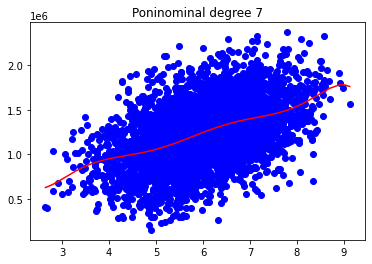

################
[[1.00000000e+00 7.00615575e+00 4.90862183e+01 ... 1.18271124e+05
  8.28625915e+05 5.80548222e+06]
 [1.00000000e+00 6.41122178e+00 4.11037647e+01 ... 6.94456110e+04
  4.45231214e+05 2.85447606e+06]
 [1.00000000e+00 4.61591791e+00 2.13066982e+01 ... 9.67271653e+03
  4.46484655e+04 2.06093652e+05]
 ...
 [1.00000000e+00 6.37806605e+00 4.06797265e+01 ... 6.73184448e+04
  4.29361487e+05 2.73849593e+06]
 [1.00000000e+00 7.29753282e+00 5.32539853e+01 ... 1.51027607e+05
  1.10212892e+06 8.04282199e+06]
 [1.00000000e+00 6.02250924e+00 3.62706176e+01 ... 4.77160902e+04
  2.87370594e+05 1.73069206e+06]]
(4000, 9)
y_pred_age (4000,)
Score: 0.21156428611308942
MAE: 248843.6582353521


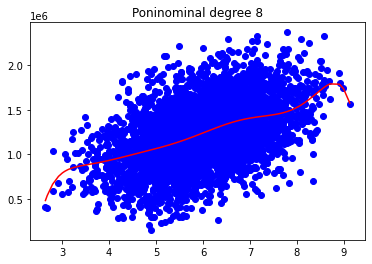

################
[[1.00000000e+00 7.00615575e+00 4.90862183e+01 ... 8.28625915e+05
  5.80548222e+06 4.06741126e+07]
 [1.00000000e+00 6.41122178e+00 4.11037647e+01 ... 4.45231214e+05
  2.85447606e+06 1.83006791e+07]
 [1.00000000e+00 4.61591791e+00 2.13066982e+01 ... 4.46484655e+04
  2.06093652e+05 9.51311378e+05]
 ...
 [1.00000000e+00 6.37806605e+00 4.06797265e+01 ... 4.29361487e+05
  2.73849593e+06 1.74663079e+07]
 [1.00000000e+00 7.29753282e+00 5.32539853e+01 ... 1.10212892e+06
  8.04282199e+06 5.86927574e+07]
 [1.00000000e+00 6.02250924e+00 3.62706176e+01 ... 2.87370594e+05
  1.73069206e+06 1.04231089e+07]]
(4000, 10)
y_pred_age (4000,)
Score: 0.2118972526762024
MAE: 248855.46096876686


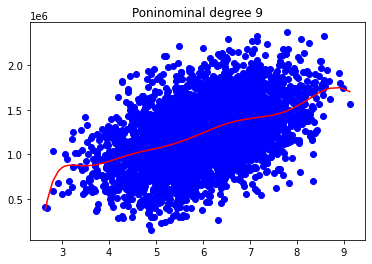

################
[[1.00000000e+00 7.00615575e+00 4.90862183e+01 ... 5.80548222e+06
  4.06741126e+07 2.84969168e+08]
 [1.00000000e+00 6.41122178e+00 4.11037647e+01 ... 2.85447606e+06
  1.83006791e+07 1.17329712e+08]
 [1.00000000e+00 4.61591791e+00 2.13066982e+01 ... 2.06093652e+05
  9.51311378e+05 4.39117523e+06]
 ...
 [1.00000000e+00 6.37806605e+00 4.06797265e+01 ... 2.73849593e+06
  1.74663079e+07 1.11401265e+08]
 [1.00000000e+00 7.29753282e+00 5.32539853e+01 ... 8.04282199e+06
  5.86927574e+07 4.28312324e+08]
 [1.00000000e+00 6.02250924e+00 3.62706176e+01 ... 1.73069206e+06
  1.04231089e+07 6.27732699e+07]]
(4000, 11)
y_pred_age (4000,)
Score: 0.2119269155246285
MAE: 248845.95589707437


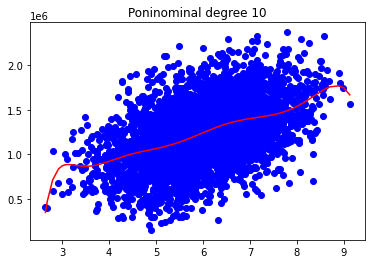

In [15]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores_age = []
for degree in range(degree_min,degree_max+1):
    
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train_age.reshape(-1, 1),y_train_age)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train_age)
    y_pred_age = lin_reg_model.predict(X_poly)
    print("y_pred_age", y_pred_age.shape)
    print("Score:", r2_score(y_train_age, y_pred_age))
    print("MAE:", mean_absolute_error(y_true=y_train_age, y_pred=y_pred_age))
    score = r2_score(y_train_age, y_pred_age)
    scores_age.append(score)
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train_age, y_train_age)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred_age = zip(*sorted(zip(X_train_age, y_pred_age)))
    plt.plot(X_train_to_show, y_pred_age, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()

    input("Enter to next grade")

In [16]:
print("SCORES - AGE\nDEGREE FROM 2 TO 10:\n",scores_age)    

SCORES - AGE
DEGREE FROM 2 TO 10:
 [0.2086351233146697, 0.2088123561095956, 0.20892305759582763, 0.21036231674888362, 0.2104995097864074, 0.21092859638527417, 0.21156428611308942, 0.2118972526762024, 0.2119269155246285]


### Conclusions: 
- Ocurre la misma situación comparando los años de la casa  con el precio, el score se estanca a partir del tercer grado del polinomio.

## X= Avg. Area Number of Rooms
## y = Price

In [19]:
X_rooms = np.array(df["Avg. Area Number of Rooms"])
y = np.array(df["Price"]) #target

print("X_rooms:", X_rooms.shape)
print("y:",y.shape)


X_rooms: (5000,)
y: (5000,)


In [20]:
X_train_rooms, X_test_rooms, y_train_rooms, y_test_rooms = train_test_split(X_rooms, y, test_size=0.2) #previus step

################
[[ 1.          7.31095034 53.44999493]
 [ 1.          7.72365986 59.6549217 ]
 [ 1.          7.3561145  54.11242061]
 ...
 [ 1.          5.35510514 28.67715111]
 [ 1.          7.11215413 50.58273632]
 [ 1.          8.72366766 76.10237753]]
(4000, 3)
y_pred_rooms (4000,)
Score: 0.11671643344476923
MAE: 266792.05002828577


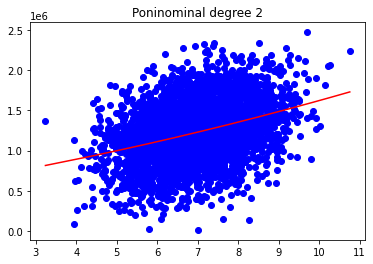

################
[[  1.           7.31095034  53.44999493 390.7702588 ]
 [  1.           7.72365986  59.6549217  460.75432445]
 [  1.           7.3561145   54.11242061 398.05716214]
 ...
 [  1.           5.35510514  28.67715111 153.56915942]
 [  1.           7.11215413  50.58273632 359.75221687]
 [  1.           8.72366766  76.10237753 663.89185006]]
(4000, 4)
y_pred_rooms (4000,)
Score: 0.11717678504650242
MAE: 266741.8174077908


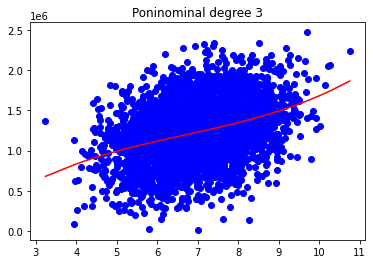

################
[[1.00000000e+00 7.31095034e+00 5.34499949e+01 3.90770259e+02
  2.85690196e+03]
 [1.00000000e+00 7.72365986e+00 5.96549217e+01 4.60754324e+02
  3.55870968e+03]
 [1.00000000e+00 7.35611450e+00 5.41124206e+01 3.98057162e+02
  2.92815406e+03]
 ...
 [1.00000000e+00 5.35510514e+00 2.86771511e+01 1.53569159e+02
  8.22378996e+02]
 [1.00000000e+00 7.11215413e+00 5.05827363e+01 3.59752217e+02
  2.55861321e+03]
 [1.00000000e+00 8.72366766e+00 7.61023775e+01 6.63891850e+02
  5.79157187e+03]]
(4000, 5)
y_pred_rooms (4000,)
Score: 0.11787368416184152
MAE: 266586.8043026176


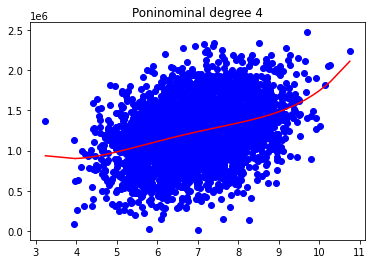

################
[[1.00000000e+00 7.31095034e+00 5.34499949e+01 3.90770259e+02
  2.85690196e+03 2.08866684e+04]
 [1.00000000e+00 7.72365986e+00 5.96549217e+01 4.60754324e+02
  3.55870968e+03 2.74862631e+04]
 [1.00000000e+00 7.35611450e+00 5.41124206e+01 3.98057162e+02
  2.92815406e+03 2.15398366e+04]
 ...
 [1.00000000e+00 5.35510514e+00 2.86771511e+01 1.53569159e+02
  8.22378996e+02 4.40392599e+03]
 [1.00000000e+00 7.11215413e+00 5.05827363e+01 3.59752217e+02
  2.55861321e+03 1.81972515e+04]
 [1.00000000e+00 8.72366766e+00 7.61023775e+01 6.63891850e+02
  5.79157187e+03 5.05237482e+04]]
(4000, 6)
y_pred_rooms (4000,)
Score: 0.11787387594780996
MAE: 266587.49760709406


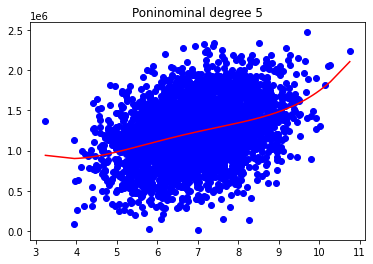

################
[[1.00000000e+00 7.31095034e+00 5.34499949e+01 ... 2.85690196e+03
  2.08866684e+04 1.52701395e+05]
 [1.00000000e+00 7.72365986e+00 5.96549217e+01 ... 3.55870968e+03
  2.74862631e+04 2.12294548e+05]
 [1.00000000e+00 7.35611450e+00 5.41124206e+01 ... 2.92815406e+03
  2.15398366e+04 1.58449504e+05]
 ...
 [1.00000000e+00 5.35510514e+00 2.86771511e+01 ... 8.22378996e+02
  4.40392599e+03 2.35834867e+04]
 [1.00000000e+00 7.11215413e+00 5.05827363e+01 ... 2.55861321e+03
  1.81972515e+04 1.29421658e+05]
 [1.00000000e+00 8.72366766e+00 7.61023775e+01 ... 5.79157187e+03
  5.05237482e+04 4.40752389e+05]]
(4000, 7)
y_pred_rooms (4000,)
Score: 0.11801392080645534
MAE: 266554.22603846574


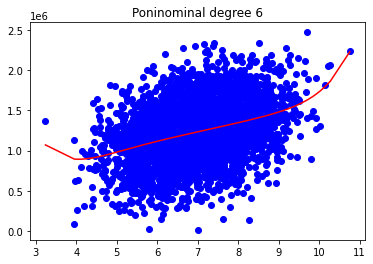

################
[[1.00000000e+00 7.31095034e+00 5.34499949e+01 ... 2.08866684e+04
  1.52701395e+05 1.11639232e+06]
 [1.00000000e+00 7.72365986e+00 5.96549217e+01 ... 2.74862631e+04
  2.12294548e+05 1.63969088e+06]
 [1.00000000e+00 7.35611450e+00 5.41124206e+01 ... 2.15398366e+04
  1.58449504e+05 1.16557270e+06]
 ...
 [1.00000000e+00 5.35510514e+00 2.86771511e+01 ... 4.40392599e+03
  2.35834867e+04 1.26292051e+05]
 [1.00000000e+00 7.11215413e+00 5.05827363e+01 ... 1.81972515e+04
  1.29421658e+05 9.20466776e+05]
 [1.00000000e+00 8.72366766e+00 7.61023775e+01 ... 5.05237482e+04
  4.40752389e+05 3.84497736e+06]]
(4000, 8)
y_pred_rooms (4000,)
Score: 0.1180323433451641
MAE: 266560.2700593624


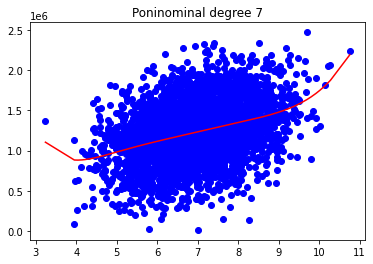

################
[[1.00000000e+00 7.31095034e+00 5.34499949e+01 ... 1.52701395e+05
  1.11639232e+06 8.16188880e+06]
 [1.00000000e+00 7.72365986e+00 5.96549217e+01 ... 2.12294548e+05
  1.63969088e+06 1.26644146e+07]
 [1.00000000e+00 7.35611450e+00 5.41124206e+01 ... 1.58449504e+05
  1.16557270e+06 8.57408622e+06]
 ...
 [1.00000000e+00 5.35510514e+00 2.86771511e+01 ... 2.35834867e+04
  1.26292051e+05 6.76307212e+05]
 [1.00000000e+00 7.11215413e+00 5.05827363e+01 ... 1.29421658e+05
  9.20466776e+05 6.54650158e+06]
 [1.00000000e+00 8.72366766e+00 7.61023775e+01 ... 4.40752389e+05
  3.84497736e+06 3.35423047e+07]]
(4000, 9)
y_pred_rooms (4000,)
Score: 0.11877574187604212
MAE: 266468.07689816825


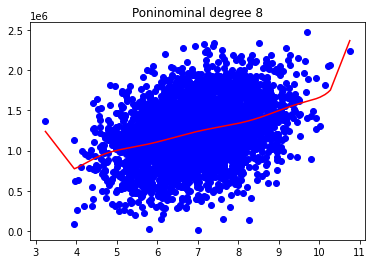

################
[[1.00000000e+00 7.31095034e+00 5.34499949e+01 ... 1.11639232e+06
  8.16188880e+06 5.96711637e+07]
 [1.00000000e+00 7.72365986e+00 5.96549217e+01 ... 1.63969088e+06
  1.26644146e+07 9.78156308e+07]
 [1.00000000e+00 7.35611450e+00 5.41124206e+01 ... 1.16557270e+06
  8.57408622e+06 6.30719600e+07]
 ...
 [1.00000000e+00 5.35510514e+00 2.86771511e+01 ... 1.26292051e+05
  6.76307212e+05 3.62169623e+06]
 [1.00000000e+00 7.11215413e+00 5.05827363e+01 ... 9.20466776e+05
  6.54650158e+06 4.65597282e+07]
 [1.00000000e+00 8.72366766e+00 7.61023775e+01 ... 3.84497736e+06
  3.35423047e+07 2.92611919e+08]]
(4000, 10)
y_pred_rooms (4000,)
Score: 0.11993706906827117
MAE: 266155.8745650965


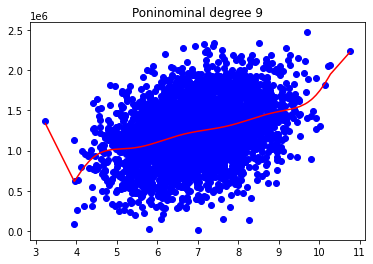

################
[[1.00000000e+00 7.31095034e+00 5.34499949e+01 ... 8.16188880e+06
  5.96711637e+07 4.36252915e+08]
 [1.00000000e+00 7.72365986e+00 5.96549217e+01 ... 1.26644146e+07
  9.78156308e+07 7.55494662e+08]
 [1.00000000e+00 7.35611450e+00 5.41124206e+01 ... 8.57408622e+06
  6.30719600e+07 4.63964560e+08]
 ...
 [1.00000000e+00 5.35510514e+00 2.86771511e+01 ... 6.76307212e+05
  3.62169623e+06 1.93945641e+07]
 [1.00000000e+00 7.11215413e+00 5.05827363e+01 ... 6.54650158e+06
  4.65597282e+07 3.31139963e+08]
 [1.00000000e+00 8.72366766e+00 7.61023775e+01 ... 3.35423047e+07
  2.92611919e+08 2.55264913e+09]]
(4000, 11)
y_pred_rooms (4000,)
Score: 0.1202307845316779
MAE: 266172.06751854706


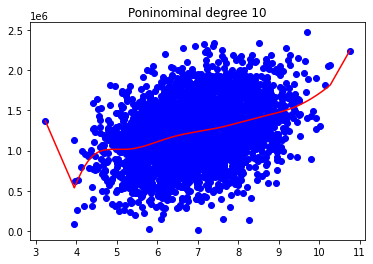

In [21]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores_rooms = []
for degree in range(degree_min,degree_max+1):
    
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train_rooms.reshape(-1, 1),y_train_rooms)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train_rooms)
    y_pred_rooms = lin_reg_model.predict(X_poly)
    print("y_pred_rooms", y_pred_rooms.shape)
    print("Score:", r2_score(y_train_rooms, y_pred_rooms))
    print("MAE:", mean_absolute_error(y_true=y_train_rooms, y_pred=y_pred_rooms))
    score = r2_score(y_train_rooms, y_pred_rooms)
    scores_rooms.append(score)
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train_rooms, y_train_rooms)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred_rooms = zip(*sorted(zip(X_train_rooms, y_pred_rooms)))
    plt.plot(X_train_to_show, y_pred_rooms, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()

    input("Enter to next grade")

In [22]:
print("SCORES - ROOMS\nDEGREE FROM 2 TO 10:\n",scores_rooms)    

SCORES - ROOMS
DEGREE FROM 2 TO 10:
 [0.11671643344476923, 0.11717678504650242, 0.11787368416184152, 0.11787387594780996, 0.11801392080645534, 0.1180323433451641, 0.11877574187604212, 0.11993706906827117, 0.1202307845316779]


### Conclusions:
 - The same situation for this time 

## X= Avg. Area Number of Bedrooms
## y = Price

In [24]:
X_bed = np.array(df["Avg. Area Number of Bedrooms"])
y = np.array(df["Price"]) #target

print("X_bed:", X_bed.shape)
print("y:",y.shape)

X_bed: (5000,)
y: (5000,)


In [25]:
X_train_bed, X_test_bed, y_train_bed, y_test_bed = train_test_split(X_bed, y, test_size=0.2) #previus step

################
[[ 1.      6.     36.    ]
 [ 1.      6.25   39.0625]
 [ 1.      4.02   16.1604]
 ...
 [ 1.      5.41   29.2681]
 [ 1.      2.38    5.6644]
 [ 1.      6.23   38.8129]]
(4000, 3)
y_pred_bed (4000,)
Score: 0.029096713457581913
MAE: 278901.0205430531


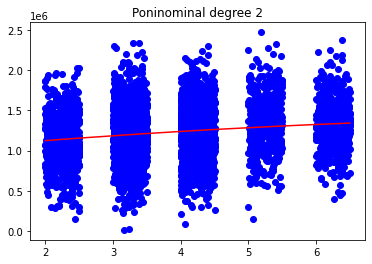

################
[[  1.         6.        36.       216.      ]
 [  1.         6.25      39.0625   244.140625]
 [  1.         4.02      16.1604    64.964808]
 ...
 [  1.         5.41      29.2681   158.340421]
 [  1.         2.38       5.6644    13.481272]
 [  1.         6.23      38.8129   241.804367]]
(4000, 4)
y_pred_bed (4000,)
Score: 0.029150266823081528
MAE: 278860.1355340896


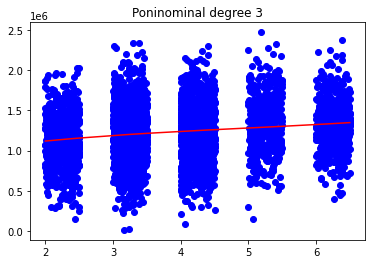

################
[[1.00000000e+00 6.00000000e+00 3.60000000e+01 2.16000000e+02
  1.29600000e+03]
 [1.00000000e+00 6.25000000e+00 3.90625000e+01 2.44140625e+02
  1.52587891e+03]
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 6.49648080e+01
  2.61158528e+02]
 ...
 [1.00000000e+00 5.41000000e+00 2.92681000e+01 1.58340421e+02
  8.56621678e+02]
 [1.00000000e+00 2.38000000e+00 5.66440000e+00 1.34812720e+01
  3.20854274e+01]
 [1.00000000e+00 6.23000000e+00 3.88129000e+01 2.41804367e+02
  1.50644121e+03]]
(4000, 5)
y_pred_bed (4000,)
Score: 0.032938604312599096
MAE: 278387.1882429056


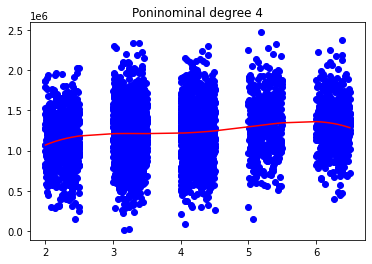

################
[[1.00000000e+00 6.00000000e+00 3.60000000e+01 2.16000000e+02
  1.29600000e+03 7.77600000e+03]
 [1.00000000e+00 6.25000000e+00 3.90625000e+01 2.44140625e+02
  1.52587891e+03 9.53674316e+03]
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 6.49648080e+01
  2.61158528e+02 1.04985728e+03]
 ...
 [1.00000000e+00 5.41000000e+00 2.92681000e+01 1.58340421e+02
  8.56621678e+02 4.63432328e+03]
 [1.00000000e+00 2.38000000e+00 5.66440000e+00 1.34812720e+01
  3.20854274e+01 7.63633171e+01]
 [1.00000000e+00 6.23000000e+00 3.88129000e+01 2.41804367e+02
  1.50644121e+03 9.38512872e+03]]
(4000, 6)
y_pred_bed (4000,)
Score: 0.033670920648158686
MAE: 278436.8160159273


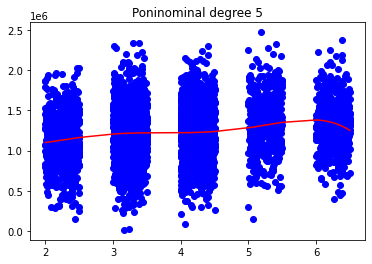

################
[[1.00000000e+00 6.00000000e+00 3.60000000e+01 ... 1.29600000e+03
  7.77600000e+03 4.66560000e+04]
 [1.00000000e+00 6.25000000e+00 3.90625000e+01 ... 1.52587891e+03
  9.53674316e+03 5.96046448e+04]
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 2.61158528e+02
  1.04985728e+03 4.22042628e+03]
 ...
 [1.00000000e+00 5.41000000e+00 2.92681000e+01 ... 8.56621678e+02
  4.63432328e+03 2.50716889e+04]
 [1.00000000e+00 2.38000000e+00 5.66440000e+00 ... 3.20854274e+01
  7.63633171e+01 1.81744695e+02]
 [1.00000000e+00 6.23000000e+00 3.88129000e+01 ... 1.50644121e+03
  9.38512872e+03 5.84693519e+04]]
(4000, 7)
y_pred_bed (4000,)
Score: 0.03644452792701991
MAE: 277960.2284425637


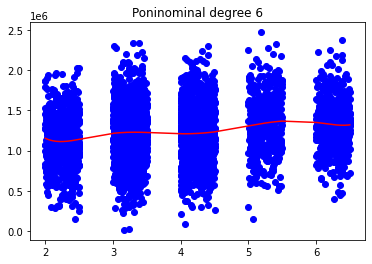

################
[[1.00000000e+00 6.00000000e+00 3.60000000e+01 ... 7.77600000e+03
  4.66560000e+04 2.79936000e+05]
 [1.00000000e+00 6.25000000e+00 3.90625000e+01 ... 9.53674316e+03
  5.96046448e+04 3.72529030e+05]
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 1.04985728e+03
  4.22042628e+03 1.69661136e+04]
 ...
 [1.00000000e+00 5.41000000e+00 2.92681000e+01 ... 4.63432328e+03
  2.50716889e+04 1.35637837e+05]
 [1.00000000e+00 2.38000000e+00 5.66440000e+00 ... 7.63633171e+01
  1.81744695e+02 4.32552373e+02]
 [1.00000000e+00 6.23000000e+00 3.88129000e+01 ... 9.38512872e+03
  5.84693519e+04 3.64264062e+05]]
(4000, 8)
y_pred_bed (4000,)
Score: 0.036489082902383396
MAE: 277938.6539076652


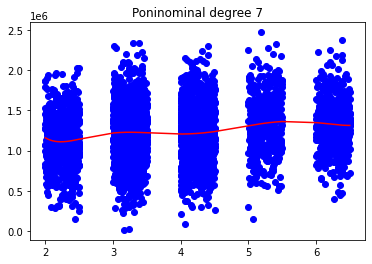

################
[[1.00000000e+00 6.00000000e+00 3.60000000e+01 ... 4.66560000e+04
  2.79936000e+05 1.67961600e+06]
 [1.00000000e+00 6.25000000e+00 3.90625000e+01 ... 5.96046448e+04
  3.72529030e+05 2.32830644e+06]
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 4.22042628e+03
  1.69661136e+04 6.82037768e+04]
 ...
 [1.00000000e+00 5.41000000e+00 2.92681000e+01 ... 2.50716889e+04
  1.35637837e+05 7.33800699e+05]
 [1.00000000e+00 2.38000000e+00 5.66440000e+00 ... 1.81744695e+02
  4.32552373e+02 1.02947465e+03]
 [1.00000000e+00 6.23000000e+00 3.88129000e+01 ... 5.84693519e+04
  3.64264062e+05 2.26936511e+06]]
(4000, 9)
y_pred_bed (4000,)
Score: 0.03658875080016677
MAE: 277889.34700045077


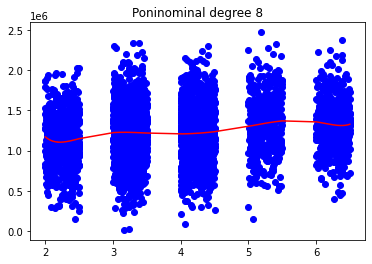

################
[[1.00000000e+00 6.00000000e+00 3.60000000e+01 ... 2.79936000e+05
  1.67961600e+06 1.00776960e+07]
 [1.00000000e+00 6.25000000e+00 3.90625000e+01 ... 3.72529030e+05
  2.32830644e+06 1.45519152e+07]
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 1.69661136e+04
  6.82037768e+04 2.74179183e+05]
 ...
 [1.00000000e+00 5.41000000e+00 2.92681000e+01 ... 1.35637837e+05
  7.33800699e+05 3.96986178e+06]
 [1.00000000e+00 2.38000000e+00 5.66440000e+00 ... 4.32552373e+02
  1.02947465e+03 2.45014966e+03]
 [1.00000000e+00 6.23000000e+00 3.88129000e+01 ... 3.64264062e+05
  2.26936511e+06 1.41381446e+07]]
(4000, 10)
y_pred_bed (4000,)
Score: 0.036685181564706904
MAE: 277889.8081835071


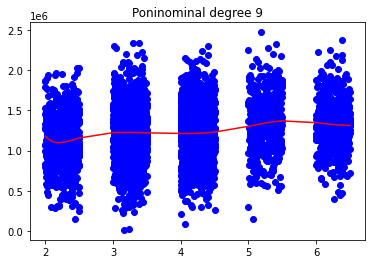

################
[[1.00000000e+00 6.00000000e+00 3.60000000e+01 ... 1.67961600e+06
  1.00776960e+07 6.04661760e+07]
 [1.00000000e+00 6.25000000e+00 3.90625000e+01 ... 2.32830644e+06
  1.45519152e+07 9.09494702e+07]
 [1.00000000e+00 4.02000000e+00 1.61604000e+01 ... 6.82037768e+04
  2.74179183e+05 1.10220032e+06]
 ...
 [1.00000000e+00 5.41000000e+00 2.92681000e+01 ... 7.33800699e+05
  3.96986178e+06 2.14769522e+07]
 [1.00000000e+00 2.38000000e+00 5.66440000e+00 ... 1.02947465e+03
  2.45014966e+03 5.83135620e+03]
 [1.00000000e+00 6.23000000e+00 3.88129000e+01 ... 2.26936511e+06
  1.41381446e+07 8.80806410e+07]]
(4000, 11)
y_pred_bed (4000,)
Score: 0.03681409084019338
MAE: 277852.001655452


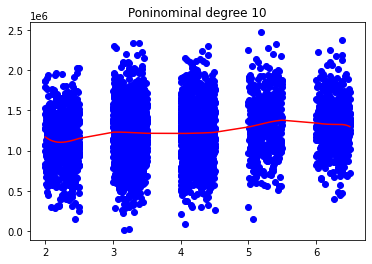

In [26]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores_bed = []
for degree in range(degree_min,degree_max+1):
    
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train_bed.reshape(-1, 1),y_train_bed)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train_bed)
    y_pred_bed = lin_reg_model.predict(X_poly)
    print("y_pred_bed", y_pred_bed.shape)
    print("Score:", r2_score(y_train_bed, y_pred_bed))
    print("MAE:", mean_absolute_error(y_true=y_train_bed, y_pred=y_pred_bed))
    score = r2_score(y_train_bed, y_pred_bed)
    scores_bed.append(score)
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train_bed, y_train_bed)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred_bed = zip(*sorted(zip(X_train_bed, y_pred_bed)))
    plt.plot(X_train_to_show, y_pred_bed, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()

    input("Enter to next grade")

In [27]:
print("SCORES - BEDROOMS\nDEGREE FROM 2 TO 10:\n",scores_bed) 

SCORES - BEDROOMS
DEGREE FROM 2 TO 10:
 [0.029096713457581913, 0.029150266823081528, 0.032938604312599096, 0.033670920648158686, 0.03644452792701991, 0.036489082902383396, 0.03658875080016677, 0.036685181564706904, 0.03681409084019338]


### Conclusions

- Although the increase is a little greater from the third degree on, the same situation continues as in the previous comparisons, reaching the third-fourth degree in this case, the score stagnates and it is not efficient to increase the degree of the polynomial.

## X=  Area Population
## y = Price

In [28]:
X_pop = np.array(df["Area Population"])
y = np.array(df["Price"]) #target

print("X_pop:", X_pop.shape)
print("y:",y.shape)

X_pop: (5000,)
y: (5000,)


In [29]:
X_train_pop, X_test_pop, y_train_pop, y_test_pop = train_test_split(X_pop, y, test_size=0.2) #previus step

################
[[1.00000000e+00 4.65206922e+04 2.16417480e+09]
 [1.00000000e+00 4.34671470e+04 1.88939287e+09]
 [1.00000000e+00 2.75305660e+04 7.57932064e+08]
 ...
 [1.00000000e+00 5.22656012e+04 2.73169306e+09]
 [1.00000000e+00 4.47955311e+04 2.00663961e+09]
 [1.00000000e+00 5.11729470e+04 2.61867051e+09]]
(4000, 3)
y_pred_pop (4000,)
Score: 0.1623548727667088
MAE: 256873.8414271574


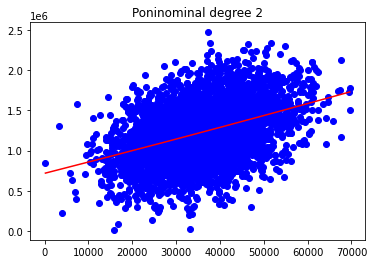

################
[[1.00000000e+00 4.65206922e+04 2.16417480e+09 1.00678910e+14]
 [1.00000000e+00 4.34671470e+04 1.88939287e+09 8.21265177e+13]
 [1.00000000e+00 2.75305660e+04 7.57932064e+08 2.08662987e+13]
 ...
 [1.00000000e+00 5.22656012e+04 2.73169306e+09 1.42773580e+14]
 [1.00000000e+00 4.47955311e+04 2.00663961e+09 8.98884870e+13]
 [1.00000000e+00 5.11729470e+04 2.61867051e+09 1.34005087e+14]]
(4000, 4)
y_pred_pop (4000,)
Score: 0.16237182033975828
MAE: 256890.52665754902


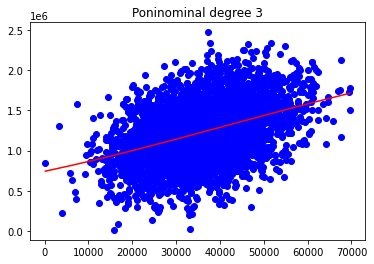

################
[[1.00000000e+00 4.65206922e+04 2.16417480e+09 1.00678910e+14
  4.68365257e+18]
 [1.00000000e+00 4.34671470e+04 1.88939287e+09 8.21265177e+13
  3.56980542e+18]
 [1.00000000e+00 2.75305660e+04 7.57932064e+08 2.08662987e+13
  5.74461014e+17]
 ...
 [1.00000000e+00 5.22656012e+04 2.73169306e+09 1.42773580e+14
  7.46214700e+18]
 [1.00000000e+00 4.47955311e+04 2.00663961e+09 8.98884870e+13
  4.02660252e+18]
 [1.00000000e+00 5.11729470e+04 2.61867051e+09 1.34005087e+14
  6.85743523e+18]]
(4000, 5)
y_pred_pop (4000,)
Score: 0.16227335226173578
MAE: 256903.15445504602


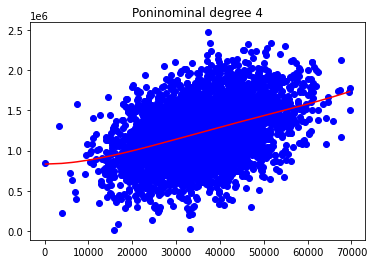

################
[[1.00000000e+00 4.65206922e+04 2.16417480e+09 1.00678910e+14
  4.68365257e+18 2.17886760e+23]
 [1.00000000e+00 4.34671470e+04 1.88939287e+09 8.21265177e+13
  3.56980542e+18 1.55169257e+23]
 [1.00000000e+00 2.75305660e+04 7.57932064e+08 2.08662987e+13
  5.74461014e+17 1.58152368e+22]
 ...
 [1.00000000e+00 5.22656012e+04 2.73169306e+09 1.42773580e+14
  7.46214700e+18 3.90013599e+23]
 [1.00000000e+00 4.47955311e+04 2.00663961e+09 8.98884870e+13
  4.02660252e+18 1.80373798e+23]
 [1.00000000e+00 5.11729470e+04 2.61867051e+09 1.34005087e+14
  6.85743523e+18 3.50915170e+23]]
(4000, 6)
y_pred_pop (4000,)
Score: 0.16171611475342385
MAE: 257038.22921409964


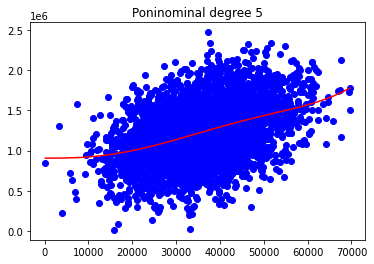

################
[[1.00000000e+00 4.65206922e+04 2.16417480e+09 ... 4.68365257e+18
  2.17886760e+23 1.01362429e+28]
 [1.00000000e+00 4.34671470e+04 1.88939287e+09 ... 3.56980542e+18
  1.55169257e+23 6.74476492e+27]
 [1.00000000e+00 2.75305660e+04 7.57932064e+08 ... 5.74461014e+17
  1.58152368e+22 4.35402422e+26]
 ...
 [1.00000000e+00 5.22656012e+04 2.73169306e+09 ... 7.46214700e+18
  3.90013599e+23 2.03842952e+28]
 [1.00000000e+00 4.47955311e+04 2.00663961e+09 ... 4.02660252e+18
  1.80373798e+23 8.07994009e+27]
 [1.00000000e+00 5.11729470e+04 2.61867051e+09 ... 6.85743523e+18
  3.50915170e+23 1.79573634e+28]]
(4000, 7)
y_pred_pop (4000,)
Score: 0.16029417915937927
MAE: 257305.80888923834


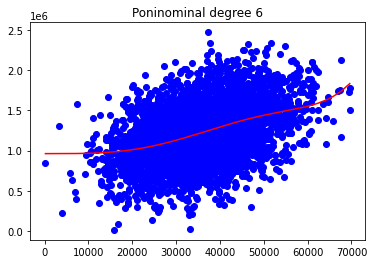

################
[[1.00000000e+00 4.65206922e+04 2.16417480e+09 ... 2.17886760e+23
  1.01362429e+28 4.71545035e+32]
 [1.00000000e+00 4.34671470e+04 1.88939287e+09 ... 1.55169257e+23
  6.74476492e+27 2.93175688e+32]
 [1.00000000e+00 2.75305660e+04 7.57932064e+08 ... 1.58152368e+22
  4.35402422e+26 1.19868751e+31]
 ...
 [1.00000000e+00 5.22656012e+04 2.73169306e+09 ... 3.90013599e+23
  2.03842952e+28 1.06539744e+33]
 [1.00000000e+00 4.47955311e+04 2.00663961e+09 ... 1.80373798e+23
  8.07994009e+27 3.61945208e+32]
 [1.00000000e+00 5.11729470e+04 2.61867051e+09 ... 3.50915170e+23
  1.79573634e+28 9.18931207e+32]]
(4000, 8)
y_pred_pop (4000,)
Score: 0.15761445102949478
MAE: 257778.37126914418


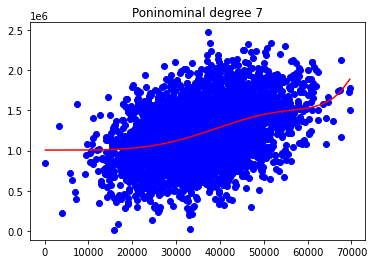

################
[[1.00000000e+00 4.65206922e+04 2.16417480e+09 ... 1.01362429e+28
  4.71545035e+32 2.19366014e+37]
 [1.00000000e+00 4.34671470e+04 1.88939287e+09 ... 6.74476492e+27
  2.93175688e+32 1.27435108e+37]
 [1.00000000e+00 2.75305660e+04 7.57932064e+08 ... 4.35402422e+26
  1.19868751e+31 3.30005456e+35]
 ...
 [1.00000000e+00 5.22656012e+04 2.73169306e+09 ... 2.03842952e+28
  1.06539744e+33 5.56836378e+37]
 [1.00000000e+00 4.47955311e+04 2.00663961e+09 ... 8.07994009e+27
  3.61945208e+32 1.62135278e+37]
 [1.00000000e+00 5.11729470e+04 2.61867051e+09 ... 1.79573634e+28
  9.18931207e+32 4.70244180e+37]]
(4000, 9)
y_pred_pop (4000,)
Score: 0.15347317741268984
MAE: 258454.49180873137


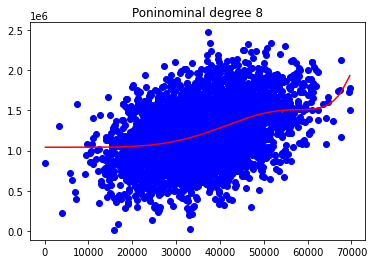

################
[[1.00000000e+00 4.65206922e+04 2.16417480e+09 ... 4.71545035e+32
  2.19366014e+37 1.02050588e+42]
 [1.00000000e+00 4.34671470e+04 1.88939287e+09 ... 2.93175688e+32
  1.27435108e+37 5.53924056e+41]
 [1.00000000e+00 2.75305660e+04 7.57932064e+08 ... 1.19868751e+31
  3.30005456e+35 9.08523699e+39]
 ...
 [1.00000000e+00 5.22656012e+04 2.73169306e+09 ... 1.06539744e+33
  5.56836378e+37 2.91033880e+42]
 [1.00000000e+00 4.47955311e+04 2.00663961e+09 ... 3.61945208e+32
  1.62135278e+37 7.26293590e+41]
 [1.00000000e+00 5.11729470e+04 2.61867051e+09 ... 9.18931207e+32
  4.70244180e+37 2.40637805e+42]]
(4000, 10)
y_pred_pop (4000,)
Score: 0.14790974890869735
MAE: 259278.97706080298


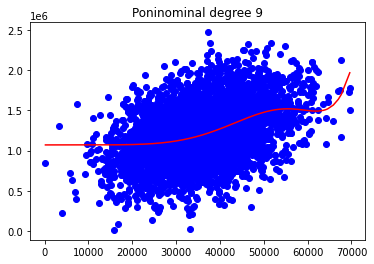

################
[[1.00000000e+00 4.65206922e+04 2.16417480e+09 ... 2.19366014e+37
  1.02050588e+42 4.74746400e+46]
 [1.00000000e+00 4.34671470e+04 1.88939287e+09 ... 1.27435108e+37
  5.53924056e+41 2.40774984e+46]
 [1.00000000e+00 2.75305660e+04 7.57932064e+08 ... 3.30005456e+35
  9.08523699e+39 2.50121716e+44]
 ...
 [1.00000000e+00 5.22656012e+04 2.73169306e+09 ... 5.56836378e+37
  2.91033880e+42 1.52110607e+47]
 [1.00000000e+00 4.47955311e+04 2.00663961e+09 ... 1.62135278e+37
  7.26293590e+41 3.25347071e+46]
 [1.00000000e+00 5.11729470e+04 2.61867051e+09 ... 4.70244180e+37
  2.40637805e+42 1.23141457e+47]]
(4000, 11)
y_pred_pop (4000,)
Score: 0.14114870810127322
MAE: 260244.29403241107


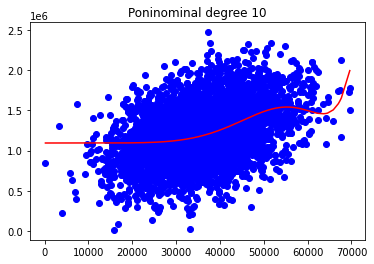

In [30]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores_pop = []
for degree in range(degree_min,degree_max+1):
    
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train_pop.reshape(-1, 1),y_train_pop)

    #######
    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train_pop)
    y_pred_pop = lin_reg_model.predict(X_poly)
    print("y_pred_pop", y_pred_pop.shape)
    print("Score:", r2_score(y_train_pop, y_pred_pop))
    print("MAE:", mean_absolute_error(y_true=y_train_pop, y_pred=y_pred_pop))
    score = r2_score(y_train_pop, y_pred_pop)
    scores_pop.append(score)
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train_pop, y_train_pop)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred_pop = zip(*sorted(zip(X_train_pop, y_pred_pop)))
    plt.plot(X_train_to_show, y_pred_pop, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()

    input("Enter to next grade")

In [31]:
print("SCORES - AREA OF POPULATION \nDEGREE FROM 2 TO 10:\n",scores_pop) 

SCORES - AREA OF POPULATION 
DEGREE FROM 2 TO 10:
 [0.1623548727667088, 0.16237182033975828, 0.16227335226173578, 0.16171611475342385, 0.16029417915937927, 0.15761445102949478, 0.15347317741268984, 0.14790974890869735, 0.14114870810127322]


### Conclusions:

### It continues to present a very bad score and even on this occasion, the more the grade is increased, the score is decreasing.

### I don't think this model is the most suitable for training this model.